# DIABLO: Biological Analyses: miRNA-mRNA in Breast Cancer  subtypes

#### IMPORTS

In [ ]:
#!pip install matplotlib_venn

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from matplotlib_venn import venn2
from matplotlib_venn import venn2_unweighted
from scipy import stats 

In [2]:
path = 'C:\\Users\\arati\\OneDrive - FCT NOVA\\PBCM'
os.chdir(path)

### Correlations miRNA-mRNA from DIABLO

#### Data load and preprocessing

In [3]:
data_correlations_comp1 = pd.read_csv("C:\\Users\\arati\\OneDrive - FCT NOVA\\PBCM\\plotsData\\Circ_Plot_Covariance_Features_Comp1.csv")
data_correlations_comp1.shape

(254, 255)

In [4]:
data_correlations_comp1

,Unnamed: 0,MIR-9-1/9*,MIR-9-1/9,MIR-9-2/9*,MIR-9-2/9,MIR-9-3/9*,MIR-9-3/9,MIR-92-1/92A,MIR-92-13/92A,MIR-92-2/92A,...,AGR3,CDCA2,FSIP1,SMIM14,FAM171A1,PRR15,RASGEF1C,FAM174A,SFT2D2,CENPW
0,MIR-9-1/9*,0.392307,0.388569,0.392307,0.388569,0.392307,0.388569,0.399125,0.399125,0.399125,...,-0.545169,0.421307,-0.485517,-0.498317,0.515324,-0.521208,0.476264,-0.485093,0.442863,0.459802
1,MIR-9-1/9,0.388569,0.384866,0.388569,0.384866,0.388569,0.384866,0.395322,0.395322,0.395322,...,-0.539975,0.417293,-0.480891,-0.493569,0.510413,-0.516242,0.471726,-0.480471,0.438643,0.455421
2,MIR-9-2/9*,0.392307,0.388569,0.392307,0.388569,0.392307,0.388569,0.399125,0.399125,0.399125,...,-0.545169,0.421307,-0.485517,-0.498317,0.515324,-0.521208,0.476264,-0.485093,0.442863,0.459802
3,MIR-9-2/9,0.388569,0.384866,0.388569,0.384866,0.388569,0.384866,0.395322,0.395322,0.395322,...,-0.539975,0.417293,-0.480891,-0.493569,0.510413,-0.516242,0.471726,-0.480471,0.438643,0.455421
4,MIR-9-3/9*,0.392307,0.388569,0.392307,0.388569,0.392307,0.388569,0.399125,0.399125,0.399125,...,-0.545169,0.421307,-0.485517,-0.498317,0.515324,-0.521208,0.476264,-0.485093,0.442863,0.459802
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249,PRR15,-0.521208,-0.516242,-0.521208,-0.516242,-0.521208,-0.516242,-0.530267,-0.530267,-0.530267,...,0.724297,-0.559737,0.645045,0.662050,-0.684645,0.692463,-0.632752,0.644482,-0.588376,-0.610880
250,RASGEF1C,0.476264,0.471726,0.476264,0.471726,0.476264,0.471726,0.484542,0.484542,0.484542,...,-0.661841,0.511471,-0.589422,-0.604961,0.625608,-0.632752,0.578189,-0.588908,0.537640,0.558204
251,FAM174A,-0.485093,-0.480471,-0.485093,-0.480471,-0.485093,-0.480471,-0.493524,-0.493524,-0.493524,...,0.674110,-0.520953,0.600349,0.616176,-0.637205,0.644482,-0.588908,0.599825,-0.547606,-0.568551
252,SFT2D2,0.442863,0.438643,0.442863,0.438643,0.442863,0.438643,0.450560,0.450560,0.450560,...,-0.615425,0.475600,-0.548085,-0.562534,0.581733,-0.588376,0.537640,-0.547606,0.499934,0.519056


In [5]:
data_correlations_comp1.set_index('Unnamed: 0', inplace=True)
data_correlations_comp1.index.name = None
data_correlations_comp1.head()
data_correlations_comp1.shape

(254, 254)

In [6]:
data_correlations_comp2 = pd.read_csv("C:\\Users\\arati\\OneDrive - FCT NOVA\\PBCM\\plotsData\\Circ_Plot_Covariance_Features_Comp2.csv")
data_correlations_comp2.shape

(173, 174)

In [7]:
data_correlations_comp2.set_index('Unnamed: 0', inplace=True)
data_correlations_comp2.index.name = None
data_correlations_comp2.head()
data_correlations_comp2.shape

(173, 173)

In [8]:
def get_nRows(data):
    return len(data)

In [9]:
def get_nCols(data):
    return len(data.columns)    

In [10]:
def check_miR(name):
    name = name.split('-')
    if name[0] == 'MIR' or name[0] == 'LET':
        return True
    else:
        return False
    

In [11]:
def df_correlations(data_correlations, comp):
    df = pd.DataFrame(columns = ['Feature_1', 'Feature_2', 'Type_1', 'Type_2', 'Covariance', 'Component'])
    miRNA = 'miRNA'
    mRNA = 'mRNA'
    for i in range(0, get_nRows(data_correlations)):
        for j in range(0, get_nCols(data_correlations)): 
            if i<j:
                feature1 = data_correlations.index[i]
                feature2 = data_correlations.columns[j]
                if(check_miR(feature1)):
                    type1 = miRNA
                else:
                    type1 = mRNA
                if(check_miR(feature2)):
                    type2 = miRNA
                else:
                    type2 = mRNA
                df = pd.concat([df, pd.DataFrame([{'Feature_1': feature1, 'Feature_2': feature2, 'Type_1': type1, 'Type_2': type2, 'Covariance': data_correlations.iloc[i,j], 'Component': comp}])], ignore_index=True)
    return df

In [12]:
df_comp1 = df_correlations(data_correlations_comp1, 1)
df_comp1.head(3)

C:\Users\arati\AppData\Local\Temp\ipykernel_2204\2437380833.py:18: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, pd.DataFrame([{'Feature_1': feature1, 'Feature_2': feature2, 'Type_1': type1, 'Type_2': type2, 'Covariance': data_correlations.iloc[i,j], 'Component': comp}])], ignore_index=True)


,Feature_1,Feature_2,Type_1,Type_2,Covariance,Component
0,MIR-9-1/9*,MIR-9-1/9,miRNA,miRNA,0.388569,1
1,MIR-9-1/9*,MIR-9-2/9*,miRNA,miRNA,0.392307,1
2,MIR-9-1/9*,MIR-9-2/9,miRNA,miRNA,0.388569,1


In [13]:
df_comp1.shape

(32131, 6)

In [14]:
df_comp2 = df_correlations(data_correlations_comp2, 2)
df_comp2.head(3)

C:\Users\arati\AppData\Local\Temp\ipykernel_2204\2437380833.py:18: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, pd.DataFrame([{'Feature_1': feature1, 'Feature_2': feature2, 'Type_1': type1, 'Type_2': type2, 'Covariance': data_correlations.iloc[i,j], 'Component': comp}])], ignore_index=True)


,Feature_1,Feature_2,Type_1,Type_2,Covariance,Component
0,MIR-887/887,MIR-887/3P,miRNA,miRNA,0.209683,2
1,MIR-887/887,MIR-887/5P,miRNA,miRNA,0.209683,2
2,MIR-887/887,MIR-99/99A,miRNA,miRNA,-0.324146,2


In [15]:
df_comp2.shape

(14878, 6)

In [16]:
df_concat = pd.concat([df_comp1, df_comp2])
df_concat.shape

(47009, 6)

In [17]:
#Covariance cutoff = 0.7
mask_covariance = df_concat['Covariance'].abs() >= 0.7
df_concat_filtered = df_concat.loc[mask_covariance]
df_concat_filtered = df_concat_filtered.reset_index()
df_concat_filtered  = df_concat_filtered.drop(columns = {'index'})
df_concat_filtered.head(3)

,Feature_1,Feature_2,Type_1,Type_2,Covariance,Component
0,MIR-505/505,CA12,miRNA,mRNA,-0.703769,1
1,MIR-505/505,FOXA1,miRNA,mRNA,-0.727949,1
2,MIR-505/505,MLPH,miRNA,mRNA,-0.734082,1


In [18]:
df_concat_filtered.shape

(1015, 6)

### Extract genes to obtain the established interactions in the database

In [19]:
def extractGenes(df):
    genes = []
    miRNA = 'miRNA'
    mRNA = 'mRNA'
    for i in range(0, get_nRows(df)):
        type1 = df['Type_1'][i]
        type2 = df['Type_2'][i]
        if((type1 == mRNA) and (type2 == mRNA)):
           feature1 = df['Feature_1'][i]
           feature2 = df['Feature_2'][i]
           for feature in [feature1, feature2]:
               if feature not in genes:
                genes.append(feature)

    return genes


In [26]:
def file_genes(genes, filename):
    file = open(filename, 'w')
    for i in range(0, len(genes)):
        file.write(genes[i] + '\n')
    file.close()

In [20]:
genes = extractGenes(df_concat_filtered)
genes

['AR',
 'ART3',
 'CA12',
 'ESR1',
 'FBP1',
 'GATA3',
 'FOXA1',
 'STAC',
 'UGT8',
 'XBP1',
 'ANXA9',
 'AGR2',
 'TBC1D9',
 'SPDEF',
 'PSAT1',
 'VGLL1',
 'P4HTM',
 'MLPH',
 'THSD4',
 'SLC44A4',
 'PPP1R14C',
 'B3GNT5',
 'SRSF12',
 'SRARP',
 'AGR3',
 'FAM171A1',
 'PRR15',
 'CCNE1',
 'FOXC1',
 'FOXL1',
 'IFRD1',
 'MYB',
 'YBX1',
 'TFF3',
 'FZD9',
 'KCNK5',
 'MATN4',
 'INPP4B',
 'TTLL4',
 'TSPAN1',
 'LPIN1',
 'SLC7A8',
 'MTHFD1L',
 'GPR160',
 'ZMYND10',
 'TMBIM4',
 'BCL11A',
 'ROPN1',
 'SIDT1',
 'YEATS2',
 'ATOSA',
 'CCDC170',
 'DYNLRB2',
 'HORMAD1',
 'LEMD1',
 'AMER1',
 'CHODL',
 'ROPN1B',
 'SMIM14',
 'DACH1',
 'ERBB4',
 'IL6ST',
 'LDHB',
 'MAPK4',
 'DNALI1',
 'LY6D',
 'GABBR2',
 'ZFYVE16',
 'TMCC2',
 'ARSG',
 'EVL',
 'SCUBE2',
 'ANKRA2',
 'RAB17',
 'BBOF1',
 'NUDT12',
 'HPDL',
 'CAPN13',
 'ACOT4',
 'HAPLN3',
 'FSIP1',
 'RASGEF1C',
 'FAM174A',
 'WFS1',
 'LIMA1',
 'ZNF552']

In [28]:
len(genes)

86

In [ ]:
file_genes(genes, 'dataBio\\genes.txt')

### Extract genes from original dataset to make an ORA
Note: Genes from original dataset are the reference and the genes from diablo are the ones which we want to see 

In [92]:
genes_OR = pd.read_csv("C:\\Users\\arati\\OneDrive - FCT NOVA\\PBCM\\Data_TGCA\\BRCA_mRNAs_expression.txt", sep = '\t')
genes_OR

,entrezGeneId,hugoGeneSymbol,type,TCGA-A1-A0SD-01,TCGA-A1-A0SE-01,TCGA-A1-A0SH-01,TCGA-A1-A0SJ-01,TCGA-A1-A0SK-01,TCGA-A1-A0SM-01,TCGA-A1-A0SO-01,...,TCGA-E2-A15O-01,TCGA-E2-A15P-01,TCGA-E2-A15R-01,TCGA-E2-A1B0-01,TCGA-E2-A1B1-01,TCGA-E2-A1B4-01,TCGA-E2-A1B5-01,TCGA-E2-A1B6-01,TCGA-E2-A1BC-01,TCGA-E2-A1BD-01
0,-2948,MIR-16/3P,miRNA,0.453500,1.061750,0.373875,0.515750,-0.177375,0.671875,0.777875,...,1.402125,0.611250,0.839625,0.48550,0.406125,0.686375,-0.019875,0.640375,1.062250,1.180875
1,-2946,MIR-16/16,miRNA,0.453500,1.061750,0.373875,0.515750,-0.177375,0.671875,0.777875,...,1.402125,0.611250,0.839625,0.48550,0.406125,0.686375,-0.019875,0.640375,1.062250,1.180875
2,-2945,MIR-16/5P,miRNA,0.453500,1.061750,0.373875,0.515750,-0.177375,0.671875,0.777875,...,1.402125,0.611250,0.839625,0.48550,0.406125,0.686375,-0.019875,0.640375,1.062250,1.180875
3,-2942,MIR-16-1/16,miRNA,0.453500,1.061750,0.373875,0.515750,-0.177375,0.671875,0.777875,...,1.402125,0.611250,0.839625,0.48550,0.406125,0.686375,-0.019875,0.640375,1.062250,1.180875
4,-2930,MIR-16-13/16,miRNA,0.453500,1.061750,0.373875,0.515750,-0.177375,0.671875,0.777875,...,1.402125,0.611250,0.839625,0.48550,0.406125,0.686375,-0.019875,0.640375,1.062250,1.180875
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17190,158055,C9ORF163,unknown,-0.308000,-0.416000,-0.695000,-0.806500,-0.379000,-1.093000,-0.536000,...,-0.175000,-0.784000,-0.028000,-0.32850,-0.851000,-0.293000,0.294000,0.045500,-0.673000,-0.305500
17191,317702,VN1R3,unknown,-0.265667,0.014667,0.066333,-0.079667,0.169400,0.140500,0.218333,...,-0.103833,0.036000,0.149833,0.43460,0.332400,-0.763500,0.586333,-0.109833,0.250500,-0.060500
17192,401827,MSLNL,unknown,0.344750,0.392250,0.463500,0.258000,0.016750,0.313750,0.337500,...,0.144000,0.348750,0.181750,0.30625,-0.145500,0.184500,0.371500,-0.189500,0.318250,0.241250
17193,414061,DNAJB3,unknown,0.097750,0.159000,0.441625,0.468000,0.178714,0.021125,-0.187125,...,0.338875,0.448375,0.160125,-0.29350,-0.263500,-0.121000,0.236375,1.031250,-0.111143,0.385375


In [94]:
filter_non_mir = genes_OR['type'] != 'miRNA'
genes_OR_filtered = genes_OR.loc[filter_non_mir]
genes_OR_filtered.reset_index(inplace= True)
genes_OR_filtered

,index,entrezGeneId,hugoGeneSymbol,type,TCGA-A1-A0SD-01,TCGA-A1-A0SE-01,TCGA-A1-A0SH-01,TCGA-A1-A0SJ-01,TCGA-A1-A0SK-01,TCGA-A1-A0SM-01,...,TCGA-E2-A15O-01,TCGA-E2-A15P-01,TCGA-E2-A15R-01,TCGA-E2-A1B0-01,TCGA-E2-A1B1-01,TCGA-E2-A1B4-01,TCGA-E2-A1B5-01,TCGA-E2-A1B6-01,TCGA-E2-A1BC-01,TCGA-E2-A1BD-01
0,6,750,GAS8-AS1,ncRNA,0.275667,0.419833,0.430833,0.446000,-0.169333,0.132000,...,-0.019500,-0.044667,0.040667,0.046000,0.019500,0.349000,0.765333,0.064333,0.498333,0.418333
1,7,5003,SLC22A18AS,ncRNA,0.153833,-0.768833,-0.585333,-0.651667,-1.369833,0.614833,...,-0.334833,-0.766000,-0.542167,0.011667,-0.689667,-0.100000,0.783500,1.430167,0.203000,-0.441500
2,8,8123,PWAR5,ncRNA,-0.309000,-0.068000,-0.398000,-0.250000,-0.022000,0.355500,...,0.197500,0.401000,0.762500,-1.371000,0.868000,0.305500,-0.510000,-1.885500,1.072000,0.499000
3,9,8552,INE1,ncRNA,-1.249833,-1.311333,-1.619667,-1.459167,-1.391333,-1.315500,...,-0.387667,-0.150833,-0.933000,-1.719833,-1.209000,-1.402667,-0.356500,-1.612000,-0.997667,-1.059167
4,10,9597,SMAD5-AS1,ncRNA,0.155833,0.218000,0.191667,0.346667,1.228167,-0.395500,...,0.314333,1.027833,0.455000,-0.582000,0.725000,0.249167,-0.414000,0.431000,0.300667,0.012333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17184,17190,158055,C9ORF163,unknown,-0.308000,-0.416000,-0.695000,-0.806500,-0.379000,-1.093000,...,-0.175000,-0.784000,-0.028000,-0.328500,-0.851000,-0.293000,0.294000,0.045500,-0.673000,-0.305500
17185,17191,317702,VN1R3,unknown,-0.265667,0.014667,0.066333,-0.079667,0.169400,0.140500,...,-0.103833,0.036000,0.149833,0.434600,0.332400,-0.763500,0.586333,-0.109833,0.250500,-0.060500
17186,17192,401827,MSLNL,unknown,0.344750,0.392250,0.463500,0.258000,0.016750,0.313750,...,0.144000,0.348750,0.181750,0.306250,-0.145500,0.184500,0.371500,-0.189500,0.318250,0.241250
17187,17193,414061,DNAJB3,unknown,0.097750,0.159000,0.441625,0.468000,0.178714,0.021125,...,0.338875,0.448375,0.160125,-0.293500,-0.263500,-0.121000,0.236375,1.031250,-0.111143,0.385375


In [95]:
def extract(df, filename):
    genes = []
    for i in range(0, len(df)):
        genes.append(df['hugoGeneSymbol'][i])
    file_genes(genes, filename)
    return genes

In [96]:
extract(genes_OR, 'dataBio\\genes_OR.txt')

['MIR-16/3P',
 'MIR-16/16',
 'MIR-16/5P',
 'MIR-16-1/16',
 'MIR-16-13/16',
 'MIR-16-2/16',
 'GAS8-AS1',
 'SLC22A18AS',
 'PWAR5',
 'INE1',
 'SMAD5-AS1',
 'KIAA0087',
 'FAM30A',
 'LINC01587',
 'NBR2',
 'DSCR4',
 'DLEU1',
 'MIR9-1HG',
 'HCP5',
 'ANKRD13C-DT',
 'TP53TG1',
 'LINC01565',
 'FAM215A',
 'YWHAH-AS1',
 'PART1',
 'LINC01558',
 'TCL6',
 'SND1-IT1',
 'FOXN3-AS2',
 'CPS1-IT1',
 'LINC03124',
 'LINC00312',
 'DELEC1',
 'SNHG32',
 'PBX3-DT',
 'CDKN2A-AS1',
 'IGF2-AS',
 'WT1-AS',
 'EPCIP-AS1',
 'LINC00158',
 'LINC00308',
 'EPB41L4A-DT',
 'PRR34',
 'LINC01949',
 'MEG3',
 'GSN-AS1',
 'HYMAI',
 'LINC00474',
 'BPESC1',
 'RHPN1-AS1',
 'LINC01711',
 'HAND2-AS1',
 'ANP32A-IT1',
 'FAM106A',
 'LINC00574',
 'BIN3-IT1',
 'RUNX1-IT1',
 'MIR600HG',
 'LINC00597',
 'ZNF205-AS1',
 'TTTY5',
 'TTTY9A',
 'TTTY11',
 'TTTY12',
 'TTTY13',
 'TTTY14',
 'ZBTB7C-AS2',
 'LINC01547',
 'LINC00852',
 'TTTY8',
 'DSCR8',
 'LINC00260',
 'ARHGAP5-AS1',
 'MIR503HG',
 'GLIS3-AS1',
 'FAM222A-AS1',
 'URB1-AS1',
 'ARRDC1-AS1',

In [97]:
extract(genes_OR_filtered, 'dataBio\\genes_OR_filtered.txt')

['GAS8-AS1',
 'SLC22A18AS',
 'PWAR5',
 'INE1',
 'SMAD5-AS1',
 'KIAA0087',
 'FAM30A',
 'LINC01587',
 'NBR2',
 'DSCR4',
 'DLEU1',
 'MIR9-1HG',
 'HCP5',
 'ANKRD13C-DT',
 'TP53TG1',
 'LINC01565',
 'FAM215A',
 'YWHAH-AS1',
 'PART1',
 'LINC01558',
 'TCL6',
 'SND1-IT1',
 'FOXN3-AS2',
 'CPS1-IT1',
 'LINC03124',
 'LINC00312',
 'DELEC1',
 'SNHG32',
 'PBX3-DT',
 'CDKN2A-AS1',
 'IGF2-AS',
 'WT1-AS',
 'EPCIP-AS1',
 'LINC00158',
 'LINC00308',
 'EPB41L4A-DT',
 'PRR34',
 'LINC01949',
 'MEG3',
 'GSN-AS1',
 'HYMAI',
 'LINC00474',
 'BPESC1',
 'RHPN1-AS1',
 'LINC01711',
 'HAND2-AS1',
 'ANP32A-IT1',
 'FAM106A',
 'LINC00574',
 'BIN3-IT1',
 'RUNX1-IT1',
 'MIR600HG',
 'LINC00597',
 'ZNF205-AS1',
 'TTTY5',
 'TTTY9A',
 'TTTY11',
 'TTTY12',
 'TTTY13',
 'TTTY14',
 'ZBTB7C-AS2',
 'LINC01547',
 'LINC00852',
 'TTTY8',
 'DSCR8',
 'LINC00260',
 'ARHGAP5-AS1',
 'MIR503HG',
 'GLIS3-AS1',
 'FAM222A-AS1',
 'URB1-AS1',
 'ARRDC1-AS1',
 'SNHG12',
 'TENM3-AS1',
 'LINC00923',
 'CYTOR',
 'LINC00310',
 'LINC00313',
 'B3GALT5-AS1

## Import the described interactions data from the Database
http://mirwalk.umm.uni-heidelberg.de/interactions/?bindingp=0.95&position=3UTR&page=1

In [74]:
df_genes_full = pd.read_csv(os.path.join('..', 'PBCM', 'dataBio', 'miRWalk_miRNA_Targets.csv'))
df_genes_full.head(3)

,mirnaid,refseqid,genesymbol,duplex,start,end,bindingp,energy,seed,accessibility,...,phylopstem,phylopflank,me,number_of_pairings,binding_region_length,longest_consecutive_pairings,position,validated,TargetScan,miRDB
0,hsa-miR-4251,NM_000044,AR,CCTGAGAAAAGGGCCAA#GGCTCATTTCTCACGGT#(((((((((....,10306,10323,0.953846,-19.7,1,0.001501,...,0.805119,0.963682,-5.413130,14,17,7,3UTR,NaN,0,0
1,hsa-miR-642b-5p,NM_000044,AR,GGTTCCCTCTCCAAATGTGTCT#ACAAGGGAGAGGGGAACCT#(((...,6196,6215,0.953846,-22.7,1,0.001790,...,0.922452,1.062045,-6.818995,15,19,8,3UTR,NaN,0,0
2,hsa-miR-765,NM_000044,AR,TGGAGGAGAAGGAAGGTGATG#CTTTCTCTCCTTTCTTTTTCTTCT...,4058,4083,0.956044,-21.6,1,0.905971,...,0.141278,0.438831,-3.793325,17,20,15,3UTR,NaN,0,0


In [75]:
df_genes_full.shape

(52040, 21)

In [100]:
# Get only the validated interactions

df_genes_validated = df_genes_full.dropna(subset = ['validated'])
df_genes_validated = df_genes_validated.reset_index()
df_genes_validated = df_genes_validated.drop(columns = 'index')
df_genes_validated.head(3)

,mirnaid,refseqid,genesymbol,duplex,start,end,bindingp,energy,seed,accessibility,...,phylopstem,phylopflank,me,number_of_pairings,binding_region_length,longest_consecutive_pairings,position,validated,TargetScan,miRDB
0,hsa-miR-552-3p,NM_001348061,AR,AACAGGTGACTGGTTAGACAA#TGACTCAGGCGGATGCAGTGAAGC...,2800,2842,0.961538,-22.7,1,0.000864,...,0.0,0.0,-4.957001,16,19,10,3UTR,MIRT481694,0,0
1,hsa-miR-5193,NM_001348061,AR,TCCTCCTCTACCTCATCCCAGT#ACAGGGATGTTGTGAGGACGGGC...,2649,2672,0.961538,-22.5,1,0.000270,...,0.0,0.0,-9.629898,18,23,7,3UTR,MIRT624691,0,1
2,hsa-miR-552-3p,NM_001348064,AR,AACAGGTGACTGGTTAGACAA#TGACTCAGGCGGATGCAGTGAAGC...,2717,2759,0.961538,-22.7,1,0.000864,...,0.0,0.0,-4.957001,16,19,10,3UTR,MIRT481694,0,0


In [101]:
df_genes_validated.shape

(705, 21)

## Data cross:  DIABLO Interactions vs DB Interactions

### Process miRNA names

In [52]:
#Process miRNA names at "df_concat_filtered" to match the names from the DB
df_concat_filtered.head(3)

,Feature_1,Feature_2,Type_1,Type_2,Covariance,Component
0,MIR-505/505,CA12,miRNA,mRNA,-0.703769,1
1,MIR-505/505,FOXA1,miRNA,mRNA,-0.727949,1
2,MIR-505/505,MLPH,miRNA,mRNA,-0.734082,1


In [53]:
def translate_miRNA_name(name):
    miRNA = 'hsa-' + name.lower()
    miRNA = re.sub("mir", 'miR', miRNA)
    count_ = len(re.findall("[-]", miRNA))
    count_stars = len(re.findall('[*]', miRNA))
    miRNA = re.sub('[*]', '', miRNA)
    splitted = miRNA.split('/')
    splitted2 = splitted[0].split('-')
    if(count_ == 2 ):
        if(splitted2[2] == splitted[1]):
            miRNA = splitted[0]
        else:
            miRNA =  re.sub('/', '-', miRNA)
    if(count_ == 3):
        if(splitted2[2] == splitted[1]):
            miRNA = splitted[0]
        else:
            miRNA =  re.sub('/', '-', miRNA)
    if(count_stars == 1):
        miRNA = splitted[0] + '*'
    return miRNA
        

In [54]:
def translate_df_miRNA(df_input):
    df = df_input.copy()
    miRNA = 'miRNA'
    for i in range(0, get_nRows(df)):
        type1 = df['Type_1'][i]
        type2 = df['Type_2'][i]
        if(type1 == miRNA):
            df['Feature_1'][i] =  translate_miRNA_name(df['Feature_1'][i])
        if(type2 == miRNA):
            df['Feature_2'][i] =  translate_miRNA_name(df['Feature_2'][i])
    return df


In [55]:
df_miRNA_mRNA = translate_df_miRNA(df_concat_filtered)
df_miRNA_mRNA.head(3)

C:\Users\arati\AppData\Local\Temp\ipykernel_14896\287689034.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['Feature_1'][i] =  translate_miRNA_name(df['Feature_1'][i])
C:\Users\arati\AppData\Local\Temp\ipykernel_14896\287689034.py:8: 

,Feature_1,Feature_2,Type_1,Type_2,Covariance,Component
0,hsa-miR-505,CA12,miRNA,mRNA,-0.703769,1
1,hsa-miR-505,FOXA1,miRNA,mRNA,-0.727949,1
2,hsa-miR-505,MLPH,miRNA,mRNA,-0.734082,1


In [73]:
df_miRNA_mRNA.shape

(1015, 6)

In [56]:
#Switch to have 'miRNA', 'mRNA'

def  switch(df_init):
    df = df_init
    count = 0
    miRNA = 'miRNA'
    mRNA = 'mRNA'
    for i in range(0, get_nRows(df)):
        type1 = df['Type_1'][i]
        type2  = df['Type_2'][i]
        if(type1 == mRNA) and (type2 == miRNA):
            print(222)
            feature = df['Feature_1'][i]
            df['Feature_1'][i] = df['Feature_2'][i]
            df['Feature_2'][i] =  feature
            df['Type_1'] = miRNA
            df['Type_2'] = mRNA
            count += 1
        #if(type1 == miRNA) and (type2 == mRNA):
         #   print(333)
    return df

In [57]:
switch(df_miRNA_mRNA )

,Feature_1,Feature_2,Type_1,Type_2,Covariance,Component
0,hsa-miR-505,CA12,miRNA,mRNA,-0.703769,1
1,hsa-miR-505,FOXA1,miRNA,mRNA,-0.727949,1
2,hsa-miR-505,MLPH,miRNA,mRNA,-0.734082,1
3,hsa-miR-505*,FOXA1,miRNA,mRNA,-0.705117,1
4,hsa-miR-505*,MLPH,miRNA,mRNA,-0.711058,1
...,...,...,...,...,...,...
1010,SRSF12,PRR15,mRNA,mRNA,-0.719757,1
1011,CHODL,AGR3,mRNA,mRNA,-0.701752,1
1012,SRARP,AGR3,mRNA,mRNA,0.721670,1
1013,AGR3,FAM171A1,mRNA,mRNA,-0.716120,1


### Cross the data from DIABLO and from DB

In [58]:
def get_genes_miRNA(df, col1, col2):
    genes_miRNA = []
    for i in range(0, get_nRows(df)):
        genes_miRNA.append((df[col1][i], df[col2][i]))
    return genes_miRNA

#### For validated interactions in the DB

In [59]:
genes_miRNA_DIABLO = get_genes_miRNA(df_miRNA_mRNA, 'Feature_1', 'Feature_2')
genes_miRNA_DIABLO

[('hsa-miR-505', 'CA12'),
 ('hsa-miR-505', 'FOXA1'),
 ('hsa-miR-505', 'MLPH'),
 ('hsa-miR-505*', 'FOXA1'),
 ('hsa-miR-505*', 'MLPH'),
 ('hsa-miR-505-3p', 'CA12'),
 ('hsa-miR-505-3p', 'FOXA1'),
 ('hsa-miR-505-3p', 'MLPH'),
 ('hsa-miR-505-5p', 'CA12'),
 ('hsa-miR-505-5p', 'FOXA1'),
 ('hsa-miR-505-5p', 'MLPH'),
 ('hsa-miR-20a*', 'FOXA1'),
 ('hsa-miR-20a*', 'MLPH'),
 ('hsa-miR-20a', 'FOXA1'),
 ('hsa-miR-20a', 'MLPH'),
 ('hsa-miR-20a-20', 'FOXA1'),
 ('hsa-miR-20a-20', 'MLPH'),
 ('hsa-miR-20a-5p', 'FOXA1'),
 ('hsa-miR-20a-5p', 'MLPH'),
 ('hsa-miR-19a', 'hsa-miR-19a*'),
 ('hsa-miR-19a', 'hsa-miR-19a-3p'),
 ('hsa-miR-19a', 'hsa-miR-19a-5p'),
 ('hsa-miR-19a', 'hsa-miR-18a*'),
 ('hsa-miR-19a', 'hsa-miR-18a'),
 ('hsa-miR-19a', 'hsa-miR-18a-3p'),
 ('hsa-miR-19a', 'hsa-miR-18a-18;18a'),
 ('hsa-miR-19a', 'hsa-miR-18a-5p'),
 ('hsa-miR-19a', 'AR'),
 ('hsa-miR-19a', 'ART3'),
 ('hsa-miR-19a', 'CA12'),
 ('hsa-miR-19a', 'ESR1'),
 ('hsa-miR-19a', 'GATA3'),
 ('hsa-miR-19a', 'FOXA1'),
 ('hsa-miR-19a', 'STAC'

In [61]:
len(genes_miRNA_DIABLO)

1015

In [80]:
genes_miRNA_DB_validated = get_genes_miRNA(df_genes_validated, 'mirnaid', 'genesymbol')
genes_miRNA_DB_validated

[('hsa-miR-552-3p', 'AR'),
 ('hsa-miR-5193', 'AR'),
 ('hsa-miR-552-3p', 'AR'),
 ('hsa-miR-5193', 'AR'),
 ('hsa-miR-1910-3p', 'AR'),
 ('hsa-miR-6809-3p', 'AR'),
 ('hsa-miR-491-5p', 'AR'),
 ('hsa-miR-491-5p', 'AR'),
 ('hsa-let-7b-5p', 'AR'),
 ('hsa-miR-30c-2-3p', 'AR'),
 ('hsa-miR-625-5p', 'AR'),
 ('hsa-miR-548h-3p', 'AR'),
 ('hsa-miR-3148', 'AR'),
 ('hsa-miR-3149', 'AR'),
 ('hsa-miR-3612', 'AR'),
 ('hsa-miR-548z', 'AR'),
 ('hsa-miR-6731-5p', 'AR'),
 ('hsa-miR-6731-5p', 'AR'),
 ('hsa-miR-6733-5p', 'AR'),
 ('hsa-miR-6739-5p', 'AR'),
 ('hsa-miR-6809-3p', 'AR'),
 ('hsa-miR-6818-5p', 'AR'),
 ('hsa-miR-6867-5p', 'AR'),
 ('hsa-let-7b-5p', 'AR'),
 ('hsa-miR-30c-2-3p', 'AR'),
 ('hsa-miR-625-5p', 'AR'),
 ('hsa-miR-548h-3p', 'AR'),
 ('hsa-miR-3148', 'AR'),
 ('hsa-miR-3149', 'AR'),
 ('hsa-miR-3612', 'AR'),
 ('hsa-miR-548z', 'AR'),
 ('hsa-miR-6731-5p', 'AR'),
 ('hsa-miR-6731-5p', 'AR'),
 ('hsa-miR-6733-5p', 'AR'),
 ('hsa-miR-6739-5p', 'AR'),
 ('hsa-miR-6809-3p', 'AR'),
 ('hsa-miR-6818-5p', 'AR'),
 (

In [81]:
len(genes_miRNA_DB_validated)

705

In [65]:
def compare(set1, set2):
    same = []
    for i in range(0, len(set1)):
        for j in range(0, len(set2)):
            #print(set1[i])
            #print(set2[j])
            if(set1[i]==set2[j]):
                #print(1)
                same.append(set1[i])
    return same


In [82]:
compare(genes_miRNA_DB_validated, genes_miRNA_DIABLO)

[]

#### For non-validated and validated interactions in the DB

In [83]:
genes_miRNA_DB_full = get_genes_miRNA(df_genes_full, 'mirnaid', 'genesymbol')

In [84]:
genes_miRNA_DB_full

[('hsa-miR-4251', 'AR'),
 ('hsa-miR-642b-5p', 'AR'),
 ('hsa-miR-765', 'AR'),
 ('hsa-let-7e-5p', 'AR'),
 ('hsa-miR-296-3p', 'AR'),
 ('hsa-miR-552-3p', 'AR'),
 ('hsa-miR-630', 'AR'),
 ('hsa-miR-891a-5p', 'AR'),
 ('hsa-miR-3186-3p', 'AR'),
 ('hsa-miR-3622b-3p', 'AR'),
 ('hsa-miR-4715-5p', 'AR'),
 ('hsa-miR-5193', 'AR'),
 ('hsa-let-7e-5p', 'AR'),
 ('hsa-miR-296-3p', 'AR'),
 ('hsa-miR-552-3p', 'AR'),
 ('hsa-miR-630', 'AR'),
 ('hsa-miR-891a-5p', 'AR'),
 ('hsa-miR-3186-3p', 'AR'),
 ('hsa-miR-3622b-3p', 'AR'),
 ('hsa-miR-4715-5p', 'AR'),
 ('hsa-miR-5193', 'AR'),
 ('hsa-miR-199a-3p', 'AR'),
 ('hsa-miR-199b-3p', 'AR'),
 ('hsa-miR-1276', 'AR'),
 ('hsa-miR-1910-3p', 'AR'),
 ('hsa-miR-3160-3p', 'AR'),
 ('hsa-miR-3660', 'AR'),
 ('hsa-miR-4452', 'AR'),
 ('hsa-miR-4486', 'AR'),
 ('hsa-miR-4655-5p', 'AR'),
 ('hsa-miR-6070', 'AR'),
 ('hsa-miR-6809-3p', 'AR'),
 ('hsa-miR-6811-3p', 'AR'),
 ('hsa-miR-6838-5p', 'AR'),
 ('hsa-miR-6849-3p', 'AR'),
 ('hsa-miR-6895-5p', 'AR'),
 ('hsa-miR-7515', 'AR'),
 ('hsa-mi

In [85]:
len(genes_miRNA_DB_full)

52040

In [87]:
cross = compare(genes_miRNA_DB_full, genes_miRNA_DIABLO)
cross

[('hsa-miR-505-5p', 'MLPH'),
 ('hsa-miR-18a-5p', 'INPP4B'),
 ('hsa-miR-18a-5p', 'INPP4B'),
 ('hsa-miR-18a-3p', 'INPP4B'),
 ('hsa-miR-18a-3p', 'INPP4B'),
 ('hsa-miR-18a-5p', 'INPP4B'),
 ('hsa-miR-18a-5p', 'SLC44A4'),
 ('hsa-miR-18a-5p', 'CHODL'),
 ('hsa-miR-18a-5p', 'CHODL'),
 ('hsa-miR-18a-5p', 'CHODL'),
 ('hsa-miR-135b-5p', 'CA12'),
 ('hsa-miR-135b-5p', 'CA12'),
 ('hsa-miR-19a-5p', 'STAC'),
 ('hsa-miR-18a-5p', 'STAC'),
 ('hsa-miR-18a-3p', 'SMIM14'),
 ('hsa-miR-18a-5p', 'SMIM14'),
 ('hsa-miR-18a-3p', 'SMIM14'),
 ('hsa-miR-18a-3p', 'PRR15'),
 ('hsa-miR-18a-5p', 'TTLL4')]

In [90]:
len(cross)

19

##### Venn Diagram

C:\Users\arati\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\matplotlib_venn\_util.py:32: UserWarning: venn2_unweighted is deprecated. Use venn2 with the appropriate layout_algorithm instead.
  warnings.warn(


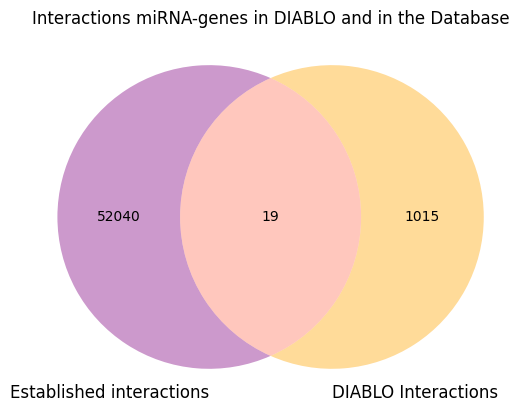

In [ ]:
venn2_unweighted(subsets = (len(genes_miRNA_DB_full), len(genes_miRNA_DIABLO), len(cross)), set_labels = ('Established interactions', 'DIABLO Interactions'), set_colors=('purple', 'orange'))
plt.title('Interactions miRNA-genes in DIABLO and in the Database')
plt.show()

## Cross PAM50 genes with DIABLO genes


In [122]:
loadings_comp1_mRNA = pd.read_csv(os.path.join('..', 'PBCM', 'plotsData',  'Loadings_Plot_mRNA_Comp1.csv'))
loadings_comp2_mRNA = pd.read_csv(os.path.join('..', 'PBCM', 'plotsData',  'Loadings_Plot_mRNA_Comp2.csv'))
genes_comp1 = loadings_comp1_mRNA['Unnamed: 0'].to_list()
genes_comp2 = loadings_comp2_mRNA['Unnamed: 0'].to_list()

In [102]:
file = open('dataBio\\genesPAM50.txt', 'r')
PAM_50 = []
for x in file :
    gene = x.strip()
    PAM_50.append(gene)
file.close()
PAM_50

['UBE2C',
 'PTTG1',
 'MYBL2',
 'BIRC5',
 'CCNB1',
 'TYMS',
 'MELK',
 'CEP55',
 'KNTC2',
 'UBE2T',
 'RRM2',
 'CDC6',
 'ANLN',
 'ORC6L',
 'KIF2C',
 'EXO1',
 'CDCA1',
 'CENPF',
 'CCNE1',
 'MKI67',
 'CDC20',
 'MMP11',
 'GRB7',
 'ERBB2',
 'TMEM45B',
 'BAG1',
 'PGR',
 'MAPT',
 'NAT1',
 'GPR160',
 'FOXA1',
 'BLVRA',
 'CXXC5',
 'ESR1',
 'SLC39A6',
 'KRT17',
 'KRT5',
 'SFRP1',
 'BCL2',
 'KRT14',
 'MLPH',
 'MDM2',
 'FGFR4',
 'MYC',
 'MIA',
 'FOXC1',
 'ACTR3B',
 'PHGDH',
 'CDH3',
 'EGFR']

In [103]:
len((PAM_50))

50

In [104]:
def intersection(x, y):
    intersection = []
    for i in range(0, len(x)):
        for j in range(0, len(y)):
            if(x[i]== y[j]):
                intersection.append(x[i])
    return intersection


In [107]:
#PAM50 genes in the interactions miRNA-mRNA with cutoff >= 0.7
genes_PAM50_int = intersection(genes, PAM_50)
genes_PAM50_int

['ESR1', 'FOXA1', 'MLPH', 'CCNE1', 'FOXC1', 'GPR160']

In [125]:
len(genes_PAM50_int)

6

In [123]:
#PAM50 genes in the component 1
genes_PAM50_comp1 = intersection(genes_comp1, PAM_50)
genes_PAM50_comp1

['MLPH',
 'FOXA1',
 'ESR1',
 'CCNE1',
 'GPR160',
 'CDC20',
 'FOXC1',
 'CXXC5',
 'NAT1',
 'MELK']

In [126]:
len(genes_PAM50_comp1)

10

In [124]:
#PAM50 genes in the component 2
genes_PAM50_comp2 = intersection(genes_comp2, PAM_50)
genes_PAM50_comp2

['CCNB1',
 'UBE2T',
 'CDC6',
 'RRM2',
 'EXO1',
 'BIRC5',
 'PTTG1',
 'CEP55',
 'MKI67',
 'UBE2C',
 'MYBL2']

In [128]:
len(genes_PAM50_comp2)

11

## Cluester Map
https://python-graph-gallery.com/405-dendrogram-with-heatmap-and-coloured-leaves/

### Data extraction

In [21]:
df_concat_filtered

,Feature_1,Feature_2,Type_1,Type_2,Covariance,Component
0,MIR-505/505,CA12,miRNA,mRNA,-0.703769,1
1,MIR-505/505,FOXA1,miRNA,mRNA,-0.727949,1
2,MIR-505/505,MLPH,miRNA,mRNA,-0.734082,1
3,MIR-505/505*,FOXA1,miRNA,mRNA,-0.705117,1
4,MIR-505/505*,MLPH,miRNA,mRNA,-0.711058,1
...,...,...,...,...,...,...
1010,SRSF12,PRR15,mRNA,mRNA,-0.719757,1
1011,CHODL,AGR3,mRNA,mRNA,-0.701752,1
1012,SRARP,AGR3,mRNA,mRNA,0.721670,1
1013,AGR3,FAM171A1,mRNA,mRNA,-0.716120,1


In [22]:
#Obtain unique miRNAs chosen from DIABLO
mask_miRNA = df_concat_filtered['Type_1']== 'miRNA'
mirna_DIABLO= df_concat_filtered.loc[mask_miRNA]
mirna_DIABLO

,Feature_1,Feature_2,Type_1,Type_2,Covariance,Component
0,MIR-505/505,CA12,miRNA,mRNA,-0.703769,1
1,MIR-505/505,FOXA1,miRNA,mRNA,-0.727949,1
2,MIR-505/505,MLPH,miRNA,mRNA,-0.734082,1
3,MIR-505/505*,FOXA1,miRNA,mRNA,-0.705117,1
4,MIR-505/505*,MLPH,miRNA,mRNA,-0.711058,1
...,...,...,...,...,...,...
494,MIR-106A/3P,CA12,miRNA,mRNA,-0.711061,1
495,MIR-106A/3P,FOXA1,miRNA,mRNA,-0.735491,1
496,MIR-106A/3P,MLPH,miRNA,mRNA,-0.741688,1
497,MIR-934/934,FOXA1,miRNA,mRNA,-0.709964,1


In [23]:
mirna_DIABLO = mirna_DIABLO['Feature_1'].unique()
mirna_DIABLO

array(['MIR-505/505', 'MIR-505/505*', 'MIR-505/3P', 'MIR-505/5P',
       'MIR-20A/20A*', 'MIR-20A/20A', 'MIR-20A/20', 'MIR-20A/5P',
       'MIR-19A/19A', 'MIR-19A/19A*', 'MIR-19A/3P', 'MIR-19A/5P',
       'MIR-19B-1/19B', 'MIR-19B-2/19B', 'MIR-20/20A', 'MIR-17/17*',
       'MIR-17/17', 'MIR-18A/18A*', 'MIR-18A/18A', 'MIR-18A/3P',
       'MIR-18A/18;18A', 'MIR-18A/5P', 'MIR-135B/135B*', 'MIR-135B/135B',
       'MIR-135B/3P', 'MIR-135B/5P', 'MIR-577/577', 'MIR-106/106A',
       'MIR-106-X/106A', 'MIR-106A/106A*', 'MIR-106A/106A', 'MIR-106A/5P',
       'MIR-106A/3P', 'MIR-934/934'], dtype=object)

In [24]:
len(mirna_DIABLO)

34

In [25]:
#Unique genes in DIABLO
genes

['AR',
 'ART3',
 'CA12',
 'ESR1',
 'FBP1',
 'GATA3',
 'FOXA1',
 'STAC',
 'UGT8',
 'XBP1',
 'ANXA9',
 'AGR2',
 'TBC1D9',
 'SPDEF',
 'PSAT1',
 'VGLL1',
 'P4HTM',
 'MLPH',
 'THSD4',
 'SLC44A4',
 'PPP1R14C',
 'B3GNT5',
 'SRSF12',
 'SRARP',
 'AGR3',
 'FAM171A1',
 'PRR15',
 'CCNE1',
 'FOXC1',
 'FOXL1',
 'IFRD1',
 'MYB',
 'YBX1',
 'TFF3',
 'FZD9',
 'KCNK5',
 'MATN4',
 'INPP4B',
 'TTLL4',
 'TSPAN1',
 'LPIN1',
 'SLC7A8',
 'MTHFD1L',
 'GPR160',
 'ZMYND10',
 'TMBIM4',
 'BCL11A',
 'ROPN1',
 'SIDT1',
 'YEATS2',
 'ATOSA',
 'CCDC170',
 'DYNLRB2',
 'HORMAD1',
 'LEMD1',
 'AMER1',
 'CHODL',
 'ROPN1B',
 'SMIM14',
 'DACH1',
 'ERBB4',
 'IL6ST',
 'LDHB',
 'MAPK4',
 'DNALI1',
 'LY6D',
 'GABBR2',
 'ZFYVE16',
 'TMCC2',
 'ARSG',
 'EVL',
 'SCUBE2',
 'ANKRA2',
 'RAB17',
 'BBOF1',
 'NUDT12',
 'HPDL',
 'CAPN13',
 'ACOT4',
 'HAPLN3',
 'FSIP1',
 'RASGEF1C',
 'FAM174A',
 'WFS1',
 'LIMA1',
 'ZNF552']

In [26]:
len(genes)

86

In [27]:
def Z_score_of_df(df_OR):
    df = df_OR
    for  i in range(0, len(df.columns)):
        df.iloc[:, [i]] = (df.iloc[:, [i]] - df.iloc[:, [i]].mean()) / df.iloc[:, [i]].std() 
    return df


In [28]:
miRNA_heatmap = pd.read_csv("C:\\Users\\arati\\OneDrive - FCT NOVA\\PBCM\\Data_TGCA\\BRCA_microRNA_expression.txt", sep = '\t')
miRNA_heatmap = miRNA_heatmap.drop(columns = ['entrezGeneId'])
miRNA_heatmap.set_index(['hugoGeneSymbol'], drop = True, inplace= True)
miRNA_heatmap = miRNA_heatmap.transpose()
miRNA_heatmap.drop('type', axis = 0, inplace = True)
miRNA_heatmap

hugoGeneSymbol,MIR-744/744*,MIR-744/744,MIR-744/3P,MIR-744/5P,MIR-758/758,MIR-758/3P,MIR-758/5P,MIR-766/766,MIR-766/3P,MIR-766/5P,...,MIR-1-1/1,MIR-1-2/1,MIR-100/100*,MIR-100/100,MIR-100/3P,MIR-100/5P,MIR-100-11/100,MIR-101/101,MIR-101/3P,MIR-101/5P
TCGA-A1-A0SE-01,3.675192,3.675192,3.675192,3.675192,2.090229,2.090229,2.090229,1.711718,1.711718,1.711718,...,2.913351,2.913351,11.65877,11.65877,11.65877,11.65877,11.65877,13.506458,13.506458,13.506458
TCGA-A1-A0SH-01,3.033211,3.033211,3.033211,3.033211,3.420234,3.420234,3.420234,2.332771,2.332771,2.332771,...,2.502696,2.502696,12.044008,12.044008,12.044008,12.044008,12.044008,11.241914,11.241914,11.241914
TCGA-A1-A0SJ-01,1.678295,1.678295,1.678295,1.678295,1.815799,1.815799,1.815799,1.678295,1.678295,1.678295,...,4.864162,4.864162,11.193798,11.193798,11.193798,11.193798,11.193798,12.224708,12.224708,12.224708
TCGA-A1-A0SK-01,3.576166,3.576166,3.576166,3.576166,-0.086799,-0.086799,-0.086799,3.537692,3.537692,3.537692,...,-1.671761,-1.671761,7.760781,7.760781,7.760781,7.760781,7.760781,11.656914,11.656914,11.656914
TCGA-A1-A0SM-01,3.332498,3.332498,3.332498,3.332498,2.110106,2.110106,2.110106,1.747536,1.747536,1.747536,...,-0.059819,-0.059819,10.579974,10.579974,10.579974,10.579974,10.579974,10.899458,10.899458,10.899458
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-BH-A0RX-01,4.082119,4.082119,4.082119,4.082119,1.365912,1.365912,1.365912,3.365912,3.365912,3.365912,...,3.258997,3.258997,12.587154,12.587154,12.587154,12.587154,12.587154,12.769457,12.769457,12.769457
TCGA-BH-A0W3-01,5.226695,5.226695,5.226695,5.226695,2.41934,2.41934,2.41934,2.797852,2.797852,2.797852,...,1.682375,1.682375,11.038827,11.038827,11.038827,11.038827,11.038827,12.036808,12.036808,12.036808
TCGA-BH-A0W4-01,3.534248,3.534248,3.534248,3.534248,3.135698,3.135698,3.135698,1.483622,1.483622,1.483622,...,-1.323733,-1.323733,12.032856,12.032856,12.032856,12.032856,12.032856,12.134802,12.134802,12.134802
TCGA-BH-A0W5-01,3.028002,3.028002,3.028002,3.028002,3.584395,3.584395,3.584395,2.39997,2.39997,2.39997,...,1.747894,1.747894,11.901265,11.901265,11.901265,11.901265,11.901265,12.751713,12.751713,12.751713


In [29]:
miRNA_heatmap = miRNA_heatmap[miRNA_heatmap.columns.intersection(mirna_DIABLO)] 
miRNA_heatmap

hugoGeneSymbol,MIR-505/505,MIR-505/505*,MIR-505/3P,MIR-505/5P,MIR-20A/20A*,MIR-20A/20A,MIR-20A/20,MIR-20A/5P,MIR-19A/19A,MIR-19A/19A*,...,MIR-135B/3P,MIR-135B/5P,MIR-577/577,MIR-106/106A,MIR-106-X/106A,MIR-106A/106A*,MIR-106A/106A,MIR-106A/5P,MIR-106A/3P,MIR-934/934
TCGA-A1-A0SE-01,2.197144,1.849221,2.197144,2.197144,1.197144,6.011841,6.011841,6.011841,3.343986,3.343986,...,2.197144,2.197144,-0.025248,3.033646,3.033646,3.033646,3.033646,3.033646,3.033646,0.974752
TCGA-A1-A0SH-01,1.654699,1.654699,1.654699,1.654699,0.917733,4.792203,4.792203,4.792203,1.917733,1.917733,...,3.239662,3.239662,1.654699,2.140126,2.140126,2.140126,2.140126,2.140126,2.140126,0.332771
TCGA-A1-A0SJ-01,2.526292,2.94133,2.526292,2.526292,2.879929,6.623154,6.623154,6.623154,4.163722,4.163722,...,2.94133,2.94133,0.356367,4.163722,4.163722,4.163722,4.163722,4.163722,4.163722,0.678295
TCGA-A1-A0SK-01,3.537692,2.576166,3.537692,3.537692,6.388935,9.905668,9.905668,9.905668,7.762867,7.762867,...,7.685791,7.685791,5.812055,7.210882,7.210882,7.210882,7.210882,7.210882,7.210882,-0.671761
TCGA-A1-A0SM-01,1.262109,0.525143,1.262109,1.262109,1.525143,5.540094,5.540094,5.540094,2.747536,2.747536,...,4.721541,4.721541,0.940181,3.188108,3.188108,3.188108,3.188108,3.188108,3.188108,-1.059819
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-BH-A0RX-01,3.602952,2.728482,3.602952,3.602952,3.14352,7.234514,7.234514,7.234514,5.300024,5.300024,...,6.066352,6.066352,2.365912,4.64602,4.64602,4.64602,4.64602,4.64602,4.64602,2.365912
TCGA-BH-A0W3-01,3.097412,2.41934,3.097412,3.097412,2.41934,7.628794,7.628794,7.628794,4.004303,4.004303,...,0.097412,0.097412,-0.902588,4.955393,4.955393,4.955393,4.955393,4.955393,4.955393,-0.902588
TCGA-BH-A0W4-01,2.676267,1.261229,2.676267,2.676267,1.998195,7.477167,7.477167,7.477167,3.483622,3.483622,...,2.846192,2.846192,0.261229,2.846192,2.846192,2.846192,2.846192,2.846192,2.846192,-0.323733
TCGA-BH-A0W5-01,2.262467,1.747894,2.262467,2.262467,2.39997,8.054281,8.054281,8.054281,3.188466,3.188466,...,2.39997,2.39997,2.110464,2.847429,2.847429,2.847429,2.847429,2.847429,2.847429,-1.059461


In [30]:
miRNA_heatmap_Z = Z_score_of_df(miRNA_heatmap)
miRNA_heatmap_Z

C:\Users\arati\AppData\Local\Temp\ipykernel_2204\3546303058.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.iloc[:, [i]] = (df.iloc[:, [i]] - df.iloc[:, [i]].mean()) / df.iloc[:, [i]].std()
C:\Users\arati\AppData\Local\Temp\ipykernel_2204\3546303058.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.iloc[:, [i]] = (df.iloc[:, [i]] - df.iloc[:, [i]].mean()) / df.iloc[:, [i]].std()
C:\Users\arati\AppData\Local\Temp\ipykernel_2204\3546303058.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

hugoGeneSymbol,MIR-505/505,MIR-505/505*,MIR-505/3P,MIR-505/5P,MIR-20A/20A*,MIR-20A/20A,MIR-20A/20,MIR-20A/5P,MIR-19A/19A,MIR-19A/19A*,...,MIR-135B/3P,MIR-135B/5P,MIR-577/577,MIR-106/106A,MIR-106-X/106A,MIR-106A/106A*,MIR-106A/106A,MIR-106A/5P,MIR-106A/3P,MIR-934/934
TCGA-A1-A0SE-01,-0.693296,-0.488771,-0.693296,-0.693296,-1.16406,-0.804222,-0.804222,-0.804222,-0.481896,-0.481896,...,-0.134923,-0.134923,-0.483721,-0.676131,-0.676131,-0.676131,-0.676131,-0.676131,-0.676131,0.539395
TCGA-A1-A0SH-01,-1.109877,-0.64238,-1.109877,-1.109877,-1.387773,-1.70952,-1.70952,-1.70952,-1.454711,-1.454711,...,0.311021,0.311021,0.308501,-1.351226,-1.351226,-1.351226,-1.351226,-1.351226,-1.351226,0.180614
TCGA-A1-A0SJ-01,-0.440521,0.373642,-0.440521,-0.440521,0.18328,-0.350465,-0.350465,-0.350465,0.077228,0.077228,...,0.183407,0.183407,-0.30376,0.177693,0.177693,0.177693,0.177693,0.177693,0.177693,0.373716
TCGA-A1-A0SK-01,0.336203,0.085281,0.336203,0.336203,2.992802,2.086037,2.086037,2.086037,2.532125,2.532125,...,2.212881,2.212881,2.269006,2.479962,2.479962,2.479962,2.479962,2.479962,2.479962,-0.380784
TCGA-A1-A0SM-01,-1.411374,-1.534364,-1.411374,-1.411374,-0.901444,-1.154385,-1.154385,-1.154385,-0.888721,-0.888721,...,0.944904,0.944904,-0.028448,-0.559427,-0.559427,-0.559427,-0.559427,-0.559427,-0.559427,-0.597656
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-BH-A0RX-01,0.38632,0.205561,0.38632,0.38632,0.394326,0.103328,0.103328,0.103328,0.852275,0.852275,...,1.520155,1.520155,0.643891,0.542092,0.542092,0.542092,0.542092,0.542092,0.542092,1.316867
TCGA-BH-A0W3-01,-0.001918,-0.038561,-0.001918,-0.001918,-0.185496,0.395988,0.395988,0.395988,-0.031508,-0.031508,...,-1.033096,-1.033096,-0.897452,0.775837,0.775837,0.775837,0.775837,0.775837,0.775837,-0.509785
TCGA-BH-A0W4-01,-0.325345,-0.953094,-0.325345,-0.325345,-0.52269,0.28344,0.28344,0.28344,-0.386653,-0.386653,...,0.142712,0.142712,-0.348625,-0.817761,-0.817761,-0.817761,-0.817761,-0.817761,-0.817761,-0.186283
TCGA-BH-A0W5-01,-0.64313,-0.568786,-0.64313,-0.64313,-0.201004,0.711813,0.711813,0.711813,-0.587972,-0.587972,...,-0.048162,-0.048162,0.523428,-0.816826,-0.816826,-0.816826,-0.816826,-0.816826,-0.816826,-0.597456


In [31]:
mRNA_heatmap = pd.read_csv("C:\\Users\\arati\\OneDrive - FCT NOVA\\PBCM\\Data_TGCA\\BRCA_mRNAs_expression.txt", sep = '\t')
mRNA_heatmap = mRNA_heatmap.drop(columns = ['entrezGeneId'])
mRNA_heatmap.set_index(['hugoGeneSymbol'], drop = True, inplace = True)
mRNA_heatmap = mRNA_heatmap.transpose()
mRNA_heatmap.drop('type', axis = 0, inplace = True)
mRNA_heatmap

hugoGeneSymbol,MIR-16/3P,MIR-16/16,MIR-16/5P,MIR-16-1/16,MIR-16-13/16,MIR-16-2/16,GAS8-AS1,SLC22A18AS,PWAR5,INE1,...,C8ORF44,C3ORF36,TUBA3FP,C11ORF40,C15ORF32,C9ORF163,VN1R3,MSLNL,DNAJB3,C8ORF17
TCGA-A1-A0SD-01,0.4535,0.4535,0.4535,0.4535,0.4535,0.4535,0.275667,0.153833,-0.309,-1.249833,...,-0.34825,0.7935,-1.682167,0.494,0.5395,-0.308,-0.265667,0.34475,0.09775,-0.27925
TCGA-A1-A0SE-01,1.06175,1.06175,1.06175,1.06175,1.06175,1.06175,0.419833,-0.768833,-0.068,-1.311333,...,-0.40725,0.55775,-1.2805,-0.038,-0.061,-0.416,0.014667,0.39225,0.159,-0.108667
TCGA-A1-A0SH-01,0.373875,0.373875,0.373875,0.373875,0.373875,0.373875,0.430833,-0.585333,-0.398,-1.619667,...,-0.75175,0.58575,-0.895167,0.182,0.8815,-0.695,0.066333,0.4635,0.441625,0.08275
TCGA-A1-A0SJ-01,0.51575,0.51575,0.51575,0.51575,0.51575,0.51575,0.446,-0.651667,-0.25,-1.459167,...,-1.41475,0.4635,-1.2005,0.281,0.788,-0.8065,-0.079667,0.258,0.468,0.1005
TCGA-A1-A0SK-01,-0.177375,-0.177375,-0.177375,-0.177375,-0.177375,-0.177375,-0.169333,-1.369833,-0.022,-1.391333,...,0.57725,0.87725,0.532167,0.16,0.5725,-0.379,0.1694,0.01675,0.178714,0.20675
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-E2-A1B4-01,0.686375,0.686375,0.686375,0.686375,0.686375,0.686375,0.349,-0.1,0.3055,-1.402667,...,0.29975,0.79125,-2.0405,0.5885,0.53,-0.293,-0.7635,0.1845,-0.121,-0.248
TCGA-E2-A1B5-01,-0.019875,-0.019875,-0.019875,-0.019875,-0.019875,-0.019875,0.765333,0.7835,-0.51,-0.3565,...,1.1135,0.25175,-1.4685,0.279,0.601,0.294,0.586333,0.3715,0.236375,0.21275
TCGA-E2-A1B6-01,0.640375,0.640375,0.640375,0.640375,0.640375,0.640375,0.064333,1.430167,-1.8855,-1.612,...,-0.191,1.151333,-2.034333,-0.157,0.776,0.0455,-0.109833,-0.1895,1.03125,-0.771667
TCGA-E2-A1BC-01,1.06225,1.06225,1.06225,1.06225,1.06225,1.06225,0.498333,0.203,1.072,-0.997667,...,-0.0175,1.06725,-2.545333,0.361,0.788,-0.673,0.2505,0.31825,-0.111143,1.19


In [32]:
mRNA_heatmap = mRNA_heatmap[mRNA_heatmap.columns.intersection(genes)]
mRNA_heatmap

hugoGeneSymbol,AR,ART3,CA12,CCNE1,DACH1,ERBB4,ESR1,FBP1,FOXC1,FOXL1,...,HAPLN3,SRARP,ROPN1B,AGR3,FSIP1,SMIM14,FAM171A1,PRR15,RASGEF1C,FAM174A
TCGA-A1-A0SD-01,3.972,-4.486333,2.4026,-2.07475,6.912,1.4259,3.08425,1.416333,0.6785,-0.083,...,-0.43175,0.396625,-1.89025,4.878,2.943,1.141,-1.74475,2.55125,-0.426,2.254
TCGA-A1-A0SE-01,3.8695,-3.461,3.2994,-2.13075,6.243,3.4921,2.386,1.976667,0.178125,0.021,...,1.3355,3.789125,1.66625,4.53975,4.337,1.347,-0.68225,2.326,-0.126,1.2795
TCGA-A1-A0SH-01,3.111167,-3.4475,2.8187,-2.0355,4.823625,2.6073,0.79125,2.272556,-0.6315,-0.222,...,1.069,2.835875,-0.492,3.883,1.776,1.934,-0.79725,2.100167,0.352167,1.2625
TCGA-A1-A0SJ-01,3.301167,-3.423167,2.9666,-1.3335,3.822,1.9906,2.495417,2.014222,-0.302625,-0.0885,...,0.8635,1.802375,-2.4825,1.4385,1.141,2.402,-1.373,2.939333,0.014667,2.357
TCGA-A1-A0SK-01,-2.427167,4.313333,-2.7102,1.2695,2.6565,-1.778,-4.860667,-1.656333,-1.856062,-0.425,...,1.75,-4.232375,-0.2845,-5.13675,0.2025,-0.43925,1.29475,-1.526583,-0.516,-0.4365
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-E2-A1B4-01,3.625667,-4.271667,3.7973,-3.07125,6.11825,3.6269,4.745333,2.887556,-1.600437,-0.7,...,0.1355,4.269625,-1.24375,5.41675,3.9615,1.49725,-1.6185,2.892333,-0.341833,1.9345
TCGA-E2-A1B5-01,-0.381667,0.202833,-1.6558,-0.7655,0.31825,-0.22,-2.410167,-0.118222,3.541187,1.6475,...,1.90475,-1.5165,4.29775,-1.846,-0.985,-0.51525,1.42925,-0.951333,0.431667,-1.2055
TCGA-E2-A1B6-01,2.9525,-3.3545,-0.5615,-1.940875,4.097125,1.3417,0.792,2.135222,-0.599938,-0.245,...,2.243,-0.016375,-1.281,4.9675,4.753,1.59925,-0.2,2.031917,-0.2555,1.8
TCGA-E2-A1BC-01,4.631333,-4.6538,2.2807,-3.074875,6.308375,3.9135,3.113833,2.186444,-1.209812,-0.051,...,0.531,4.194,-3.63825,3.536,4.55,2.07275,-1.68875,2.688667,-0.396,1.7275


In [33]:
mRNA_heatmap_Z = Z_score_of_df(mRNA_heatmap)
mRNA_heatmap_Z

C:\Users\arati\AppData\Local\Temp\ipykernel_2204\3546303058.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.iloc[:, [i]] = (df.iloc[:, [i]] - df.iloc[:, [i]].mean()) / df.iloc[:, [i]].std()
C:\Users\arati\AppData\Local\Temp\ipykernel_2204\3546303058.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.iloc[:, [i]] = (df.iloc[:, [i]] - df.iloc[:, [i]].mean()) / df.iloc[:, [i]].std()
C:\Users\arati\AppData\Local\Temp\ipykernel_2204\3546303058.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

hugoGeneSymbol,AR,ART3,CA12,CCNE1,DACH1,ERBB4,ESR1,FBP1,FOXC1,FOXL1,...,HAPLN3,SRARP,ROPN1B,AGR3,FSIP1,SMIM14,FAM171A1,PRR15,RASGEF1C,FAM174A
TCGA-A1-A0SD-01,0.609496,-0.918802,0.279058,-0.515853,1.075541,-0.380723,0.277586,-0.044433,0.791174,-0.1183,...,-1.263636,-0.398297,-0.215006,0.547683,-0.037747,0.198082,-0.5945,0.439162,-0.402371,1.176292
TCGA-A1-A0SE-01,0.550616,-0.479365,0.751006,-0.565424,0.774576,0.741119,0.01945,0.337564,0.502078,0.004924,...,0.179212,0.887524,1.144762,0.449306,0.527461,0.413725,0.25647,0.293349,-0.003407,0.04828
TCGA-A1-A0SH-01,0.114995,-0.473579,0.498034,-0.481109,0.136035,0.260717,-0.570114,0.539281,0.03431,-0.282992,...,-0.038368,0.526224,0.319591,0.258295,-0.510915,1.028203,0.164365,0.147158,0.632499,0.028602
TCGA-A1-A0SJ-01,0.22414,-0.463151,0.575867,0.140296,-0.31457,-0.074119,0.0599,0.363167,0.22432,-0.124816,...,-0.206146,0.134509,-0.441443,-0.452668,-0.768381,1.518111,-0.296761,0.690383,0.183663,1.295518
TCGA-A1-A0SK-01,-3.066471,2.852555,-2.41159,2.444451,-0.838898,-2.120278,-2.659573,-2.139169,-0.673192,-0.523514,...,0.517626,-2.152774,0.398925,-2.365028,-1.148902,-1.456141,1.839875,-2.200576,-0.522061,-1.93804
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-E2-A1B4-01,0.410547,-0.8268,1.013029,-1.397947,0.718454,0.814308,0.891673,0.958546,-0.525502,-0.849344,...,-0.800512,1.069642,0.032172,0.704374,0.375211,0.571009,-0.493385,0.659958,-0.29044,0.806462
TCGA-E2-A1B5-01,-1.891444,1.090879,-1.856705,0.643085,-1.890817,-1.274363,-1.753647,-1.090589,2.445117,1.932061,...,0.643969,-1.123407,2.150871,-1.407939,-1.630383,-1.535699,1.947598,-1.828195,0.738224,-2.82818
TCGA-E2-A1B6-01,0.02385,-0.433722,-1.280821,-0.397348,-0.190798,-0.426439,-0.569837,0.445657,0.052545,-0.310243,...,0.920129,-0.554831,0.01793,0.573714,0.696131,0.677783,0.64271,0.102977,-0.175626,0.650774
TCGA-E2-A1BC-01,0.988247,-0.990575,0.214907,-1.401156,0.803986,0.969918,0.288523,0.480576,-0.299815,-0.080385,...,-0.477611,1.040979,-0.883325,0.157373,0.613823,1.173448,-0.549649,0.528117,-0.362475,0.566853


In [34]:
subtypes_heatmap = pd.read_csv("C:\\Users\\arati\\OneDrive - FCT NOVA\\PBCM\\Data_TGCA\\BRCA_clinicalData.txt", sep = '\t')
subtypes_heatmap.set_index(['sampleId'], drop = True, inplace = True)
subtypes_heatmap = pd.DataFrame(subtypes_heatmap['PAM50_SUBTYPE'])
mask_normallike = subtypes_heatmap['PAM50_SUBTYPE'] != 'Normal-like' 
subtypes_heatmap = subtypes_heatmap.loc[mask_normallike]
subtypes_heatmap

,PAM50_SUBTYPE
sampleId,
TCGA-A2-A0T2-01,Basal-like
TCGA-A2-A04P-01,Basal-like
TCGA-A1-A0SK-01,Basal-like
TCGA-A2-A0CM-01,Basal-like
TCGA-AR-A1AR-01,Basal-like
...,...
TCGA-E2-A14W-01,Luminal B
TCGA-E2-A155-01,Luminal B
TCGA-E2-A15A-01,Luminal B


In [35]:
heatmap = miRNA_heatmap.join(mRNA_heatmap, how = 'inner')
heatmap = heatmap.join(subtypes_heatmap, how = 'inner')
heatmap

,MIR-505/505,MIR-505/505*,MIR-505/3P,MIR-505/5P,MIR-20A/20A*,MIR-20A/20A,MIR-20A/20,MIR-20A/5P,MIR-19A/19A,MIR-19A/19A*,...,SRARP,ROPN1B,AGR3,FSIP1,SMIM14,FAM171A1,PRR15,RASGEF1C,FAM174A,PAM50_SUBTYPE
TCGA-A1-A0SE-01,-0.693296,-0.488771,-0.693296,-0.693296,-1.16406,-0.804222,-0.804222,-0.804222,-0.481896,-0.481896,...,0.887524,1.144762,0.449306,0.527461,0.413725,0.25647,0.293349,-0.003407,0.04828,Luminal A
TCGA-A1-A0SH-01,-1.109877,-0.64238,-1.109877,-1.109877,-1.387773,-1.70952,-1.70952,-1.70952,-1.454711,-1.454711,...,0.526224,0.319591,0.258295,-0.510915,1.028203,0.164365,0.147158,0.632499,0.028602,Luminal A
TCGA-A1-A0SJ-01,-0.440521,0.373642,-0.440521,-0.440521,0.18328,-0.350465,-0.350465,-0.350465,0.077228,0.077228,...,0.134509,-0.441443,-0.452668,-0.768381,1.518111,-0.296761,0.690383,0.183663,1.295518,Luminal A
TCGA-A1-A0SK-01,0.336203,0.085281,0.336203,0.336203,2.992802,2.086037,2.086037,2.086037,2.532125,2.532125,...,-2.152774,0.398925,-2.365028,-1.148902,-1.456141,1.839875,-2.200576,-0.522061,-1.93804,Basal-like
TCGA-A1-A0SM-01,-1.411374,-1.534364,-1.411374,-1.411374,-0.901444,-1.154385,-1.154385,-1.154385,-0.888721,-0.888721,...,0.653811,-0.595906,0.55699,-0.24899,1.317385,0.067855,0.845097,1.276605,0.286153,Luminal B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-BH-A0RX-01,0.38632,0.205561,0.38632,0.38632,0.394326,0.103328,0.103328,0.103328,0.852275,0.852275,...,-1.243082,1.717401,-0.816075,-0.666814,-2.085274,2.434553,-1.401599,0.827326,-1.192591,Basal-like
TCGA-BH-A0W3-01,-0.001918,-0.038561,-0.001918,-0.001918,-0.185496,0.395988,0.395988,0.395988,-0.031508,-0.031508,...,1.123842,-0.953196,0.731059,0.428326,0.224253,-1.816894,0.220955,-0.269383,1.125361,Luminal B
TCGA-BH-A0W4-01,-0.325345,-0.953094,-0.325345,-0.325345,-0.52269,0.28344,0.28344,0.28344,-0.386653,-0.386653,...,0.863693,0.146681,0.568769,0.712349,0.552951,-0.320588,0.634118,-0.692729,0.499138,Luminal A
TCGA-BH-A0W5-01,-0.64313,-0.568786,-0.64313,-0.64313,-0.201004,0.711813,0.711813,0.711813,-0.587972,-0.587972,...,0.796275,0.083691,0.700012,0.472521,0.524164,0.365594,-0.15612,-0.472412,0.785626,Luminal A


In [36]:
heatmap.columns.dtype

dtype('O')

##### Cluester Map

In [37]:
heatmap_copy = heatmap

C:\Users\arati\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
C:\Users\arati\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


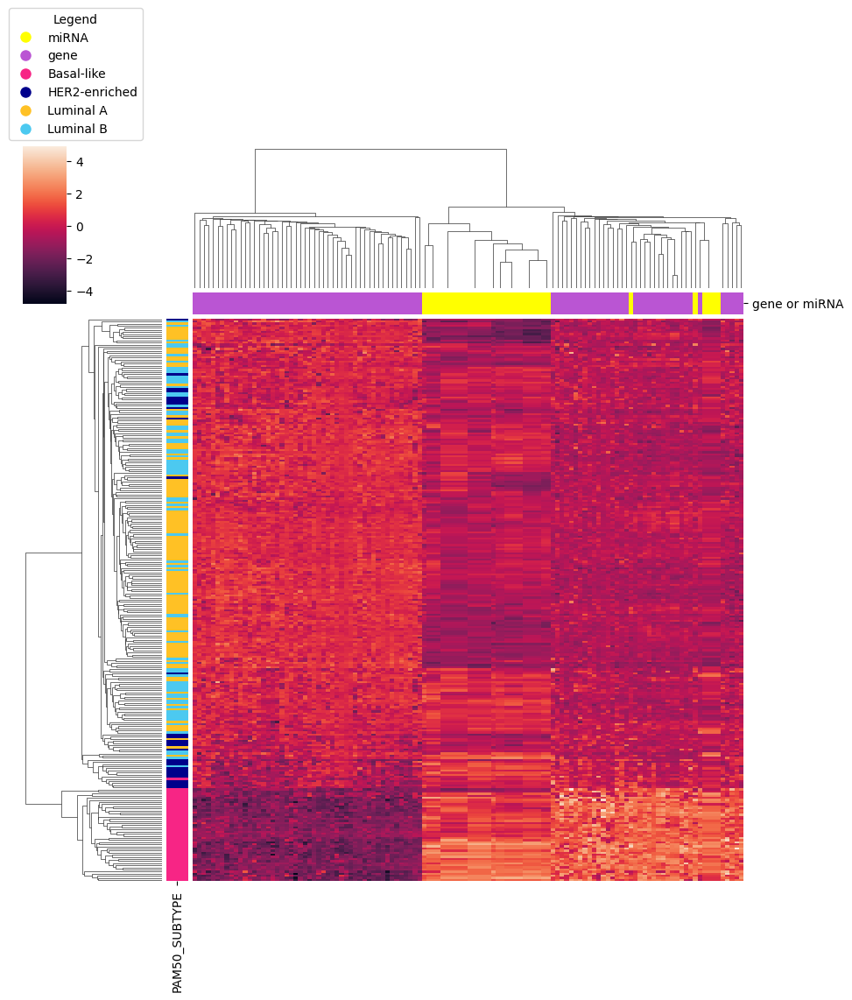

In [ ]:
subtypes = heatmap.pop('PAM50_SUBTYPE')
heatmap = heatmap.astype(float) #change to float type

row_colors_dict  = {'Basal-like': '#F72585', 'HER2-enriched': '#00008B', 'Luminal A': '#FFC125', 'Luminal B': '#4CC9F0'}
row_colors = subtypes.map(row_colors_dict)
col_colors = ["Yellow" if "MIR" in col else "mediumorchid" for col in heatmap.columns]
col_colors_df = pd.DataFrame(col_colors, index=heatmap.columns, columns=["gene or miRNA"])
col_colors_dict = {"miRNA":"Yellow", "gene": "mediumorchid"}

legend_patches = [
    plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=label) 
    for label, color in {**col_colors_dict, **row_colors_dict}.items()]
g = sns.clustermap(heatmap, col_colors=col_colors_df, row_colors= row_colors)
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_yticks([])
g.ax_heatmap.set_yticklabels([])
g.ax_heatmap.tick_params(axis='both', which='both', length=0)
plt.legend(handles=legend_patches, title="Legend", bbox_to_anchor=(1.2, 1), loc='lower center')
plt.show()